In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os

# CV A4 Q2

## 2.1

In [3]:
!pip install torch torchvision

In [4]:
# importing libraries
import torch
import torchvision
from torchvision.models import resnet50, ResNet50_Weights
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)

cuda


In [5]:
model_torch = resnet50(weights=ResNet50_Weights.IMAGENET1K_V1)

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 179MB/s]


In [6]:
!pip install ftfy regex tqdm
!pip install git+https://github.com/openai/CLIP.git

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.4/54.4 kB 3.7 MB/s eta 0:00:00
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-ngj_yk5i
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-ngj_yk5i
  Resolved https://github.com/openai/CLIP.git to commit a1d071733d7111c9c014f024669f959182114e33
  Preparing metadata (setup.py) ... done
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369497 sha256=d580d83ee493cda1df3ff72b6e3d34df70c51fdd901fbbd8c484e6abece234ed
  Stored in directory: /tmp/pip-ephem-wheel-cache-e2xwupn9/wheels/da/2b/4c/d6691fa9597aac8bb85d2ac13b112deb897d5b50f5ad9a37e4
Successfully built clip


In [7]:
import clip
clip.available_models()

['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

In [8]:
model_clip, preprocess_clip = clip.load('RN50', device)
print(model_clip)

100%|███████████████████████████████████████| 244M/244M [01:36<00:00, 2.66MiB/s]


CLIP(
  (visual): ModifiedResNet(
    (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu1): ReLU(inplace=True)
    (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu2): ReLU(inplace=True)
    (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu3): ReLU(inplace=True)
    (avgpool): AvgPool2d(kernel_size=2, stride=2, padding=0)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
     

We shall compare the architectures of the models, ImageNet and CLIP.

Both the models have the same basic architecture, Resnet50. Their convolutional layers are in residual blocks.

While ImageNet is trained on ImageNet dataset, CLIP is trained on large scale dataset comprising of image and text from internet.

Also, the final layer of the models are different. While the final layer of Imagenet is fully connected layer of 1000 neurons as output (denoting the classes), CLIP has a projection head. This projection head has 2 linear layers and norm operations. These linear layers allow CLIP to learn from joint representation of images and text

# 2.2

### ImageNet Label Hierarchy and Synsets:

(i) **Label Hierarchy in ImageNet**:
- ImageNet uses a hierarchial structure similar to WordNet. This hierarchy corresponds to there being a 'top' node, which consists of various similar objects. This top node branches out to smaller nodes, which have objects from more specific categories.

(ii) **Synset Meaning**:
- In ImageNet, a synset represents a specific category or label for images, and the words within a synset are considered to be synonyms  of each other and are semantically similar to one another. e.g. cat, kitten ,kitty are in synset

(iii) **Grouping Objects based on Synsets and Visual Recognition**:
- Grouping objects, based on synsets can lead to challenges. Objects of the same synset may exhibit diversity and variation in terms of appearance (size, shape, color.etc, context .etc. These features are useful for classifying them. But by grouping, our model may oversimply these features and ignore them. This can lead to challenges in visual recognition, as models might struggle to differentiate between objects within the same synset based on visual cues alone

(iv) **Types of Visual Differences for Objects in the Same Synset**:
- **Appearance Variations**: Objects belonging to the same synset can have different appearances due to variations in size, color, shape, texture e.g. A beach ball and football are both balls but appear different.
- **Contextual Differences**: Same objects, when in different contexts (or background settings here) may lead to visual difference. e.g. A knife may be seen as a weapon (in crime scene) and as cooking tool (in kitchen)
- **Pose and Viewpoint Changes**: Different viewpoints give different information of the same scene. This causes visual difference to pop up.

# 2.3

In [9]:
#importing other libraries
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image


In [10]:
# function to use CLIP model to evaluate an image and give back its class

# Load class labels
with open("/kaggle/input/imagenet-object-localization-challenge/LOC_synset_mapping.txt") as f:
    image_classes = [line.strip() for line in f.readlines()]

text_input = clip.tokenize(image_classes).to(device)
    
def predict_CLIP(image, top_k =1):
    image_input = preprocess_clip(image).unsqueeze(0).to(device)
    
    model_clip.cuda().eval()
    with torch.no_grad():
        image_features = model_clip.encode_image(image_input)
        text_features = model_clip.encode_text(text_input)
        
        
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    values, indices = similarity[0].topk(top_k)
#     print(values, indices)
    
    if top_k ==1:
        temp = image_classes[indices]
        class_parts = temp.split(', ')
        class_names = []
        for part in class_parts:
            words = part.split(' ')
            if len(words) > 1:
                class_names.append(' '.join(words[1:]))  # Join the words after the first one with space
            else:
                class_names.append(words[0])  # If there's only one word, add it as it is

        predicted_class = str(class_names)
    else:
        predicted_class = []
        for i in indices:
            temp = image_classes[i]
            class_parts = temp.split(',')
            class_names = []
            for part in class_parts:
                words = part.split(' ')
                if len(words) > 1:
                    class_names.append(' '.join(words[1:]))  # Join the words after the first one with space
                else:
                    class_names.append(words[0])  # If there's only one word, add it as it is

                    class_name = temp.split(',')[0].split(' ', 1)[1].strip()
            predicted_class.append(class_names)
        
    
    return predicted_class, values


 

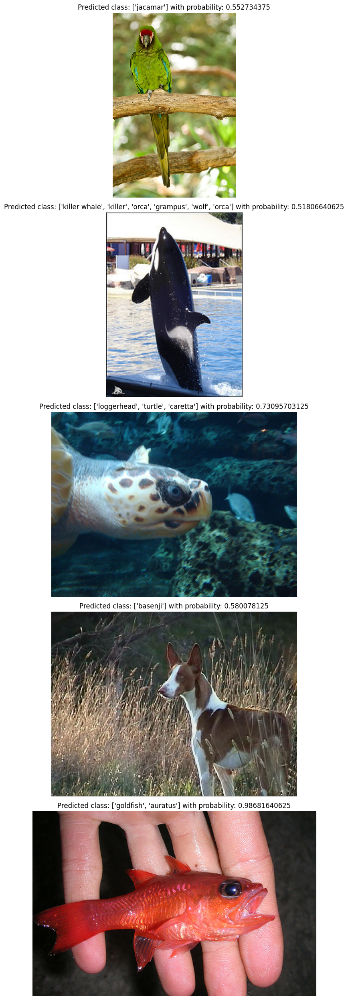

In [11]:
test_images_list = ['/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01818515/n01818515_10062.JPEG' ,'/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n02071294/n02071294_10318.JPEG','/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01664065/n01664065_10099.JPEG' ,'/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n02091244/n02091244_100.JPEG', '/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01443537/n01443537_10034.JPEG']
num_images = len(test_images_list)

num_cols = min(1, num_images)  # Maximum 3 columns
num_rows = (num_images + num_cols - 1) // num_cols

fig, axes = plt.subplots(num_rows, num_cols, figsize=(10, 5*num_rows))
axes = axes.flatten()

for i in range(num_images):
    test_image = Image.open(test_images_list[i])
    predicted_class, probability = predict_CLIP(test_image, 1)
    axes[i].imshow(test_image)
    axes[i].axis("off")
    title = "Predicted class: " + str(predicted_class) + " with probability: " + str(probability.item())
    axes[i].set_title(title)
    
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()
   
    

In [12]:
# function to predict using image net
import torch.nn.functional as F   
    
def predict_ImageNet(image, top_k = 1):
    weights = ResNet50_Weights.IMAGENET1K_V1
    preprocess_imagenet = weights.transforms().to(device)
    image = image.convert('RGB')
    image_input = preprocess_imagenet(image).unsqueeze(0).to(device)

    
    model_torch.cuda().eval()
    with torch.no_grad():
        logits = model_torch(image_input)
    probs = F.softmax(logits, dim=1) 
#     print(len(logits))
#     print(len(logits[0]))
#     print(len(probs))
#     print(len(probs[0]))

    top_probs, top_indices = torch.topk(probs, top_k, dim=1)
    
    if top_k ==1:
        values = top_probs
        predicted_class = weights.meta['categories'][top_indices]
    else:
        values = top_probs
        predicted_class = []
        for i in top_indices:
            for j in i:
                predicted_class.append(weights.meta['categories'][j])
        
    return predicted_class, values
 


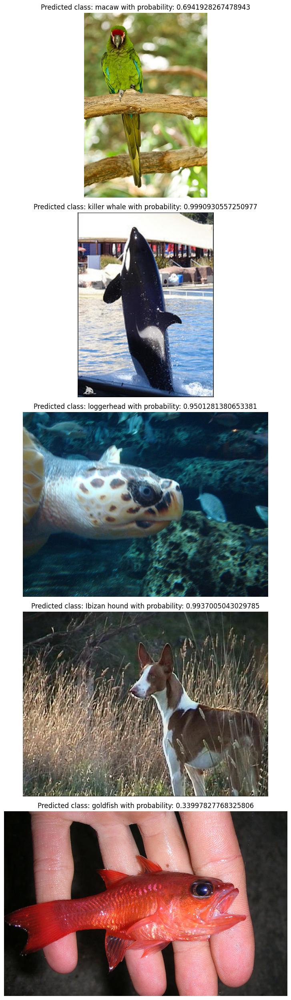

In [13]:
# testing the above function on 1 image
test_images_list = ['/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01818515/n01818515_10062.JPEG' ,'/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n02071294/n02071294_10318.JPEG','/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01664065/n01664065_10099.JPEG' ,'/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n02091244/n02091244_100.JPEG', '/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01443537/n01443537_10034.JPEG']
num_images = len(test_images_list)

num_cols = min(1, num_images)  # Maximum 3 columns
num_rows = (num_images + num_cols - 1) // num_cols

fig, axes = plt.subplots(num_rows, num_cols, figsize=(10, 5*num_rows))
axes = axes.flatten()

for i in range(num_images):
    test_image = Image.open(test_images_list[i])
    predicted_class, probability = predict_ImageNet(test_image, 1)

    axes[i].imshow(test_image)
    axes[i].axis("off")
    title = "Predicted class: " + str(predicted_class) + " with probability: " + str(probability.item())
    axes[i].set_title(title)
    
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()
   

We have predicted using ImageNet and CLIP both.

# 2.4

For 2.4, we shall look through different folders, and run both our models in them. We take both of their incorrect predictions and check if an image exists in one and not in other and vice versa. 

In [14]:
# modified clip and imagenet
import os
    
def predict_CLIP_m(images, correct_index, top_k =5):
    
    with open("/kaggle/input/imagenet-object-localization-challenge/LOC_synset_mapping.txt") as f:
        image_classes = [line.strip() for line in f.readlines()]
    text_input = clip.tokenize(image_classes).to(device)
    
    image_inputs = []
    for image in images:
        image_input = preprocess_clip(image).unsqueeze(0).to(device)
        image_inputs.append(image_input)
    image_inputs =torch.cat(image_inputs, dim=0).to(device)

    model_clip.cuda().eval()
    with torch.no_grad():
        image_features = model_clip.encode_image(image_inputs)
        text_features = model_clip.encode_text(text_input)
        
        
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    values, indices = similarity.topk(top_k)
    inc_out = []
    for i in range(len(values)):
        if correct_index not in indices[i]:
            inc_out.append(i)
          
    return inc_out


# function to predict using image net
import torch.nn.functional as F   
def predict_ImageNet_m(images, correct_index ,top_k = 5):
    image_inputs= []
    weights = ResNet50_Weights.IMAGENET1K_V1
    preprocess_imagenet = weights.transforms().to(device)
    for image in images:
        image = image.convert('RGB')
        image_input = preprocess_imagenet(image).unsqueeze(0).to(device)
        image_inputs.append(image_input)
    image_inputs =torch.cat(image_inputs, dim=0).to(device)
    
    
    model_torch.cuda().eval()
    with torch.no_grad():
        probs = model_torch(image_inputs).squeeze(0).softmax(-1)
    
    inc_out = []
    
    for i in range(len(probs)):
        sorted_idx = np.argsort(probs[i].cpu().numpy())
        top_k_indices = sorted_idx[-top_k:][::-1]
        if correct_index not in top_k_indices:
            inc_out.append(i)     
#         values, indices = probs[i].topk(top_k)
#         if correct_index not in indices:
#             inc_out.append(i)
            
    return inc_out
 


In [15]:
import random
directory_path = '/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/'

def find_index(folder_name):
    
    with open("/kaggle/input/imagenet-object-localization-challenge/LOC_synset_mapping.txt") as f:
        gt = [line.strip() for line in f.readlines()]

    l =[]
    for line in gt:
        l1 = line.split()[0]
        l.append(l1)
    
    for i in range(len(l)):
        if l[i] == folder_name:
            return i

def find_incorrect(folder_name):
    
    folder_path = directory_path + str(folder_name) + '/'
    files = os.listdir(folder_path)
#     files = sorted(files, key=lambda x: int(x.split("_")[1].split(".")[0]))
    num_samples = len(files)
    files = files[0:int(0.5*num_samples)]
    
    count =0 # used for loop breaking in debugging

    images= []
    for file in files:
        count = count +1 
        image_path = folder_path + str(file)
        image = Image.open(image_path)
        images.append(image)

    folder_index = find_index(folder_name)
    result_image_net = predict_ImageNet_m(images, folder_index)
    result_clip = predict_CLIP_m(images, folder_index)
    
    torch.cuda.empty_cache()
    
    return  result_image_net, result_clip


def find_different(folder_name):
    
    inc_imagenet , inc_clip = find_incorrect(folder_name)
    inc_clip_cor_inet = np.setdiff1d(inc_clip,inc_imagenet).tolist()
    inc_inet_cor_clip = np.setdiff1d(inc_imagenet,inc_clip).tolist()
    rand_idx_inc_inet_cor_clip = random.sample(inc_inet_cor_clip, 2)
    rand_idx_inc_clip_cor_inet = random.sample(inc_clip_cor_inet,1)
    
    final_idx = [rand_idx_inc_inet_cor_clip[0],rand_idx_inc_inet_cor_clip[1],rand_idx_inc_clip_cor_inet[0]]
    return final_idx

In [16]:
# for establishing ground truth 
with open("/kaggle/input/imagenet-object-localization-challenge/LOC_synset_mapping.txt") as f:
    gt = [line.strip() for line in f.readlines()]

gt_dict = {}

for line in gt:
    parts = line.split()
    key = parts[0]
    t_names = ' '.join(parts[1:]).split(', ')
    gt_dict[str(key)] = t_names


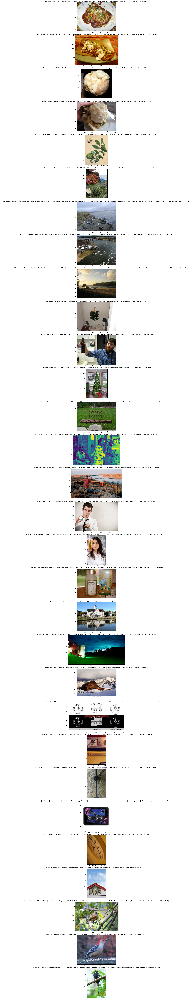

In [17]:
folders_list = ['n07880968','n07760859','n09428293','n02823428', 'n03721384' ,'n03937543', 'n02793495', 'n02708093', 'n04548280','n01843065']
num_images = len(folders_list) *3
num_cols = 1
num_rows = num_images

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))
row_counter = 0

for i in range(len(folders_list)):
    folder_name = folders_list[i]
    final_idx = find_different(folder_name)
    
    files = os.listdir(directory_path + folder_name + '/')
    
    for j in range(3):
        image_path = directory_path + folder_name + '/' + files[final_idx[j]]
        image = Image.open(image_path)
        axes[row_counter].imshow(image)  
        clip1, clip2 = predict_CLIP(image, 5)
        i1, i2 = predict_ImageNet(image,5)
        title = "Ground truth: "+ str(gt_dict[folder_name]) +"CLIP predicted: " + str(clip1) + " ImageNet predicted: " + str(i1) 
        axes[row_counter].set_title(title)
        row_counter = row_counter +1
plt.tight_layout()  
plt.show()


- The first 2 images show images in which CLIP predicted correctly but ImageNet didn't.
- The third image in each class shows in which ImageNet predicted coorectly but CLIP didn't.

We got these images from the appendix of the referenced paper in assignment. Also, we had to do trial and error for some classes. The reason for failure is"

1. Sometimes the objects of interest are confused with objects in background.
2. The viewpoint doesn't provide a complete picture or may cause lack of emphasis on special features.
3. Objects are similar to other objects.



# 2.5

In [18]:
# the default model is 32 fp only
# to get model with 16 fp, we half the model

model_16fp, preprocess_16fp = clip.load('RN50', device)

params_og = []
print("Before Halving: ")
for params in model_16fp.parameters():
    params_og.append(str(params.dtype))
params ,count = np.unique(params_og, return_counts =True)
for i in range(len(params)):
    print(params[i], count[i])
    
# after halving   
model_16fp.half()
params_half = []
print("After Halving: ")
for params in model_16fp.parameters():
    params_half.append(str(params.dtype))
params ,count = np.unique(params_half, return_counts =True)
for i in range(len(params)):
    print(params[i], count[i])

model_16fp.cuda().eval()


Before Halving: 
torch.float16 160
torch.float32 164
After Halving: 
torch.float16 324


CLIP(
  (visual): ModifiedResNet(
    (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu1): ReLU(inplace=True)
    (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu2): ReLU(inplace=True)
    (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu3): ReLU(inplace=True)
    (avgpool): AvgPool2d(kernel_size=2, stride=2, padding=0)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
     

In [19]:
model_32fp, preprocess_32fp = clip.load('RN50', device)
model_32fp.cuda().eval()

CLIP(
  (visual): ModifiedResNet(
    (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu1): ReLU(inplace=True)
    (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu2): ReLU(inplace=True)
    (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu3): ReLU(inplace=True)
    (avgpool): AvgPool2d(kernel_size=2, stride=2, padding=0)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
     

In [20]:
import time
test_images_num = 100

time_taken_16 = np.zeros(test_images_num)
time_taken_32 = np.zeros(test_images_num)

# choosing a test_folder
test_folder = '/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01601694'
files = os.listdir(test_folder)
rand_files = random.sample(files, test_images_num)

# trying out the model fp 32
for i in range(test_images_num):
    file = rand_files[i]
    image_file = test_folder+ '/' + str(file)
    image = Image.open(image_file)
    start_t = time.time()
    p_image = preprocess_32fp(image).unsqueeze(0).to(device)
    with torch.no_grad():
        output = model_32fp.encode_image(p_image)
    end_t = time.time()
    time_dif = end_t - start_t
    time_taken_32[i] = time_dif

# trying out the model fp 16
for i in range(test_images_num):
    file = rand_files[i]
    image_file = test_folder+ '/' + str(file)
    image = Image.open(image_file)
    start_t = time.time()
    p_image = preprocess_16fp(image).unsqueeze(0).to(device).half()
    with torch.no_grad():
        output = model_16fp.encode_image(p_image)
    end_t = time.time()
    time_dif = end_t - start_t
    time_taken_16[i] = time_dif



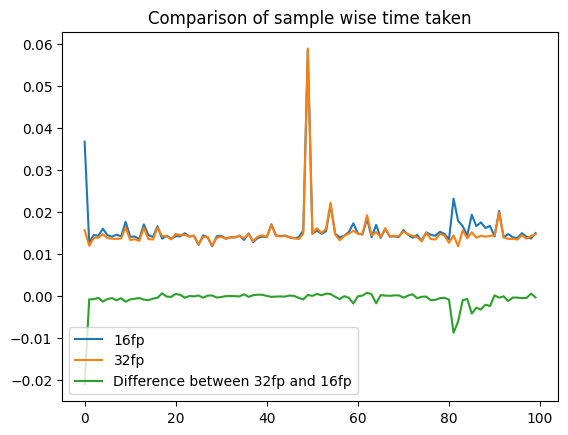

In [21]:
plt.plot(time_taken_16 , label='16fp')
plt.plot(time_taken_32, label = '32fp')
plt.plot(time_taken_32 - time_taken_16, label = 'Difference between 32fp and 16fp')
plt.legend()
plt.title('Comparison of sample wise time taken')
plt.show()

In [22]:
import pandas as pd
df_16 = pd.DataFrame(time_taken_16)
df_32 = pd.DataFrame(time_taken_32)

print("Metrics for 16fp and 32fp model are as follows:")
df_16.describe(), df_32.describe()

Metrics for 16fp and 32fp model are as follows:


(                0
 count  100.000000
 mean     0.015617
 std      0.005177
 min      0.011837
 25%      0.014030
 50%      0.014418
 75%      0.015355
 max      0.058717,
                 0
 count  100.000000
 mean     0.014898
 std      0.004671
 min      0.011853
 25%      0.013778
 50%      0.014266
 75%      0.014775
 max      0.058979)

In [23]:
# predicting with half model

with open("/kaggle/input/imagenet-object-localization-challenge/LOC_synset_mapping.txt") as f:
    image_classes = [line.strip() for line in f.readlines()]
text_input = clip.tokenize(image_classes).to(device)
    
def predict_16(image, top_k =1):
    image_input = preprocess_16fp(image).unsqueeze(0).to(device).half()
    
    model_16fp.cuda().eval()
    with torch.no_grad():
        image_features = model_16fp.encode_image(image_input)
        text_features = model_32fp.encode_text(text_input)# is same in both
        
        
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    values, indices = similarity[0].topk(top_k)
#     print(values, indices)
    
    if top_k ==1:
        temp = image_classes[indices]
        class_parts = temp.split(', ')
        class_names = []
        for part in class_parts:
            words = part.split(' ')
            if len(words) > 1:
                class_names.append(' '.join(words[1:]))  # Join the words after the first one with space
            else:
                class_names.append(words[0])  # If there's only one word, add it as it is

        predicted_class = str(class_names)
    else:
        predicted_class = []
        for i in indices:
            temp = image_classes[i]
            class_parts = temp.split(',')
            class_names = []
            for part in class_parts:
                words = part.split(' ')
                if len(words) > 1:
                    class_names.append(' '.join(words[1:]))  # Join the words after the first one with space
                else:
                    class_names.append(words[0])  # If there's only one word, add it as it is

                    class_name = temp.split(',')[0].split(' ', 1)[1].strip()
            predicted_class.append(class_names)
        
    
    return predicted_class, values


 


In [24]:
# predicting with full model

with open("/kaggle/input/imagenet-object-localization-challenge/LOC_synset_mapping.txt") as f:
    image_classes = [line.strip() for line in f.readlines()]
text_input = clip.tokenize(image_classes).to(device)
    
def predict_32(image, top_k =1):
    image_input = preprocess_32fp(image).unsqueeze(0).to(device)
    
    model_32fp.cuda().eval()
    with torch.no_grad():
        image_features = model_32fp.encode_image(image_input)
        text_features = model_32fp.encode_text(text_input)
        
        
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)
    values, indices = similarity[0].topk(top_k)
#     print(values, indices)
    
    if top_k ==1:
        temp = image_classes[indices]
        class_parts = temp.split(', ')
        class_names = []
        for part in class_parts:
            words = part.split(' ')
            if len(words) > 1:
                class_names.append(' '.join(words[1:]))  # Join the words after the first one with space
            else:
                class_names.append(words[0])  # If there's only one word, add it as it is

        predicted_class = str(class_names)
    else:
        predicted_class = []
        for i in indices:
            temp = image_classes[i]
            class_parts = temp.split(',')
            class_names = []
            for part in class_parts:
                words = part.split(' ')
                if len(words) > 1:
                    class_names.append(' '.join(words[1:]))  # Join the words after the first one with space
                else:
                    class_names.append(words[0])  # If there's only one word, add it as it is

                    class_name = temp.split(',')[0].split(' ', 1)[1].strip()
            predicted_class.append(class_names)
        
    
    return predicted_class, values


 


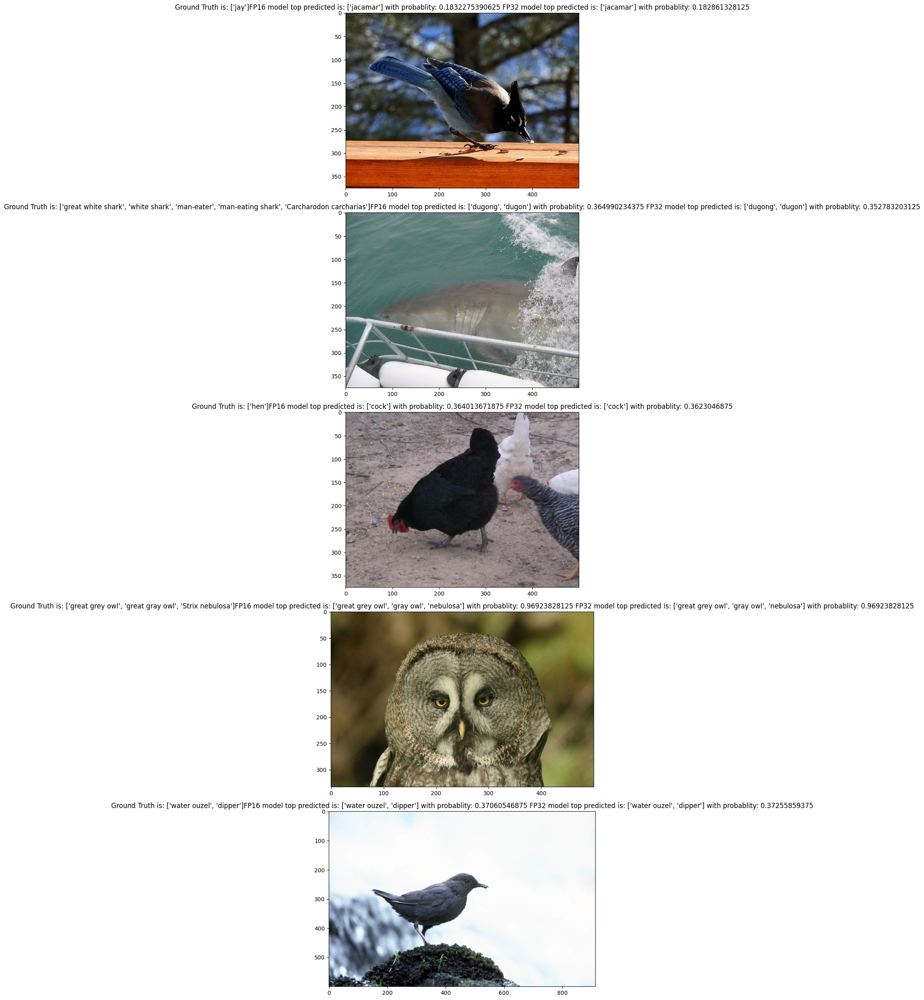

In [25]:
classes = ['/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01580077/n01580077_1000.JPEG','/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01484850/n01484850_10016.JPEG','/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01514859/n01514859_1.JPEG','/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01622779/n01622779_10.JPEG','/kaggle/input/imagenet-object-localization-challenge/ILSVRC/Data/CLS-LOC/train/n01601694/n01601694_10034.JPEG']

num_rows = len(classes)
num_cols = 1

fig, axes = plt.subplots(num_rows, num_cols, figsize=(10, 5*num_rows))

for i in range(len(classes)):
    image_path = classes[i]
    image = Image.open(image_path)
    image_name = image_path.split('/')[-1]
    image_name = image_name.split('_')[0]
    gt_class = gt_dict[image_name]
    c16, p16 = predict_16(image)
    c32, p32 = predict_32(image)
    axes[i].imshow(image)
    axes[i].set_title("Ground Truth is: " + str(gt_class) + "FP16 model top predicted is: " + str(c16) + " with probablity: " + str(p16.item()) + " FP32 model top predicted is: " + str(c32) + " with probablity: " + str(p32.item()))
    
plt.tight_layout()
plt.show()
    

Difference in performances of FP32 and FP16 is not too much here. There are no significant differences due to the change in precision being very less (order of 32 is more precise but order of 16 suffices too). Apart from this, both models are trained on similar datasets and have similar architectures.

### Profiling

In [26]:
import torch
from torch.profiler import profile, record_function, ProfilerActivity

image = Image.open(classes[0])
    
# Enable the memory profiler and run the code for FP16 model
torch.cuda.empty_cache()
with profile(activities=[ProfilerActivity.CUDA], record_shapes=True) as prof:
    predict_16(image)

print("For FP16 Model:")
print(prof.key_averages().table(sort_by="self_cuda_memory_usage", row_limit=10))

# Enable the memory profiler and run the code for FP32 model
torch.cuda.empty_cache()
with profile(activities=[ProfilerActivity.CUDA], record_shapes=True) as prof:
    predict_32(image)

print("For FP32 Model:")
print(prof.key_averages().table(sort_by="self_cuda_memory_usage", row_limit=10))



STAGE:2024-04-26 16:15:49 35:35 ActivityProfilerController.cpp:312] Completed Stage: Warm Up
STAGE:2024-04-26 16:15:50 35:35 ActivityProfilerController.cpp:318] Completed Stage: Collection
STAGE:2024-04-26 16:15:50 35:35 ActivityProfilerController.cpp:322] Completed Stage: Post Processing
STAGE:2024-04-26 16:15:50 35:35 ActivityProfilerController.cpp:312] Completed Stage: Warm Up


For FP16 Model:
-------------------------------------------------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  
                                                   Name    Self CPU %      Self CPU   CPU total %     CPU total  CPU time avg     Self CUDA   Self CUDA %    CUDA total  CUDA time avg    # of Calls  
-------------------------------------------------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  ------------  
                                        cudaMemcpyAsync         0.02%     209.000us         0.02%     209.000us      69.667us       0.000us         0.00%       0.000us       0.000us             3  
                       Memcpy HtoD (Pageable -> Device)         0.00%       0.000us         0.00%       0.000us       0.000us      52.000us         0.00%      52.000us      26.000us          

STAGE:2024-04-26 16:15:51 35:35 ActivityProfilerController.cpp:318] Completed Stage: Collection
STAGE:2024-04-26 16:15:51 35:35 ActivityProfilerController.cpp:322] Completed Stage: Post Processing


Differences between the 2 models is:
- GPU has higher power usage
- FP16 consume less memory bandwidth and so can be faster in computation

# Challenges you faced:

1. Major challenge was working on Kaggle. It seemed to crash too.
2. Took time in understanding models.